<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/a/ae/Pendule_de_Foucault.jpg/800px-Pendule_de_Foucault.jpg" align="center"/>

Foucault Pendulum - Source: Arnaud 25, Wikimedia Commons

# Lab 2: Foucault's pendulum

In this lab, we will simulate a famous experiment by [Jean Leon Foucault](https://en.wikipedia.org/wiki/Foucault_pendulum) in 1851 to demonstrate the effect of Earth's rotation on a pendulum. 

We will also introduce some basic Python tools. such as plotting and data analysis.

To use this notebook on your local machine, you will need Python3 installed.



##Colaboratory and Google Drive

Use this command to mount your Google drive. This is not required to run the lab (figures and movies will be saved to the Colab virtual machine and played in your browser). But if you would like to save output you can do so by navigating to `drive/'My Drive'` 

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
!ls drive/'My Drive'

# An introduction to Python

In this course, we will use [Python](https://www.python.org/) to run fluid dynamics simulations, analyze output, and plot figures and movies. Python is free, flexible, easy to use, and has tons of online resources for beginners. If you have a question about Python, my default answer will be "have you Googled it?"

You do not need to be fluent in Python or any other programming language for this course. We will run Python from within these notebooks, and you will get lots of guidance. You are also encouraged to complete this [free online tutorial](https://www.codecademy.com/learn/learn-python) to familiarise yourself with Python syntax.

### Jupyter notebook

We will run the python labs in [Jupyter notebook](http://jupyter.org/). Jupyter notebook is an interective, web-based, computational environment. Within a notebook you can display text, mathematical notation, images, etc, using [Markdown](https://www.markdownguide.org/). For example:

#### World's most awesome equations: 

- Newton's second law: $F = m \dot{v}$. 
- Euler's equation: $e^{\mathrm{i} \pi} + 1 = 0$. 
- Wave equation ("_gnarly dude!_"): 
$$
\frac{\partial^2 f}{\partial t^2} = c^2 \frac{\partial^2 f}{\partial x^2}.
$$

Jupyter notebook also allows you to use "cells" of python code that be executed in real time. 

To see this in action, move down to the next cell and enter the following python code: 

```
string = "Hello world!"
print(string)
```

When you are finished, press **SHIFT + ENTER** to run the cell (or click **Run** in the menu above). 

In [ ]:
# This is a comment reminding you to enter your python code below. Don't forget to press shift + enter to run!

Congratulations! You are now a pythonista. Variables carry over from cell to cell, so you can build complex scripts by sequentially running cells one after another. 

Now create a new cell by clicking on the "+" button in the menu above. Make sure that the cell type is "Code" in the drop down menu. Navigate to the new cell and enter the following python code: 

```
longer_string = string + " spam! Spam! SPAM!"
print(longer_string)
```

Don't forget to **SHIFT + ENTER** to run the cell. 


## Libraries

Python makes extensive use of freely available, open source *libraries*, which contain tonnes of useful functions etc that you can make use of. The following python code calls two standard libraries: `numpy` (pronounced "numb pie"), which contains useful functions for carrying out numerics, and `matplotlib`, which allows us to plot data.

Since we will be using these libraries repeatedly, we will abbreviate their names to `np` and `plt`, respectively.

Finally, the last line instructs `matplotlib` to plot figures in the Jupyter notebook, just below the cell that calls it. That way, you will be able to view and save figures within the notebook. 

**Move to the next cell by pressing DOWN, then press SHIFT + ENTER to run (or click "Run" in the menu above)**

In [ ]:
# Numerics
import numpy as np

# Plotting
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm

# plot figures in Jupyter notebook
%matplotlib inline

## Variables, arrays, and indexing

The first thing we need to do is define a numerical grid. We will do this using the `numpy` functions `linspace` and `meshgrid`. Thus, when we call them, we will use the alias we defined for this library, `np`, followed by a period `.` followed by the particular function we want from the library, e.g. `np.linspace`.

First, we create a vector `xv` of `2n+1` equally spaced gridpoints between $x = -1$ and $x = 1$. Again, press **shift + enter** to run the following cell. 

In [ ]:
# Grid
n = 50
xv = np.linspace(-1,1,2*n+1)

print(xv.shape)
print(xv[0:10])
print(xv[-10:])

The command `print(xv.shape)` prints the dimensions of the array `xv`. In this case, it is a 1D array with `2n+1` elements, so the dimensions are $(2n+1,)$. Notice that the second dimension is simply blank, rather than `1`. 

The commands `print(xv[0:10])` and `print(xv[-10:])` print the first and last ten elements of the array. Indexing in python is indicated using square brackets `[...]` and is referenced to the first element (for positive indices) or the last element (for negative indices). Thus, `xv[0:10]` can be read as: "first + 0 elements to first + 10 elements", and `xv[-10:]` can be read as: "last - 10 elements to last element". 

Next we will define 2D arrays `xx` and `yy` using the function `meshgrid`. 

In [ ]:
xx,yy = np.meshgrid(xv,xv,indexing='ij')

print(xx.shape)
print(yy.shape)

print(xx[0:10,0:10])
print(yy[0:10,0:10])

The array `xx` is an $2n+1 \times 2n+1$ matrix in which each row is the corresponding value of `xv`. Likewise, the array `yy` is an $2n+1 \times 2n+1$ matrix with each column having the corresponding value of `xv`. 

Let's try plotting a simple function of x and y using the arrays `xx` and `yy`. The function we will use is 

$$
f = \sin  (\pi x) 
$$

Both the sine function and the constant pi are part of the `numpy` library, so we call the using `np.sin` and `np.pi`, respectively. 

In [ ]:
# define function
f = np.sin(np.pi*xx)*np.cos(np.pi*yy)

We will make a 2D colorplot of this function using `plt.pcolormesh`, a 1D plot of a slice of the function using `plt.plot`, as well as a 3D surface plot of the function using `plot_surface` with the `Axes3D` module. We will also use some other functions from `matplotlib` to control the appearance of the figure, such as `subplot`, `title`, `xlabel`, etc. 

--------------

### Now try it yourself

- Modify the function `f` above so that it is $f = \cos (\pi y)$ and plot a 2D colormap of the function. To do this, you will need to run (**shift + enter**) both cells: the cell that defines `f` and the cell that plots `f`. 

- How should you change the 1D plot so that it shows a slice along $x = 0$ instead of $y = 0$? 

- Try plotting a more complication function like $f = \sin (\pi x) \cos (\pi y$). 

------------------

In [ ]:
# plot 2D colorplot
plt.subplot(1,2,1)
plt.pcolormesh(xx, yy, f)
plt.title('f(x,y)')
plt.xlabel('x')
plt.ylabel('y')
plt.axis('square')

# plot 1D slice along y = 0
plt.subplot(1,2,2)
plt.plot(xv,f[:,n])
plt.title('f(x,0)')
plt.xlabel('x')
plt.axis('square')
plt.ylim(-1.1,1.1)

# plot 3D colorplot ## Add exercise to subsample + show how to do ::x stepping
fig = plt.figure()
ax = fig.gca(projection='3d')
ax.plot_surface(xx, yy, f, cmap = cm.viridis)
plt.title('f(x,y)')
plt.xlabel('x')
plt.ylabel('y')

# Background
Foucault realised that, independent of any rotation of the suspension point, a pendulum will tend to maintain its plane of motion. If a rotation is observed, it must be due to his surrounding rotation (that is, the earth).

## Forces in the rotating frame

Assume that the pendulum is in a frame rotating about the $z$-axis with angular velocity $\Omega$. In this frame, the forces acting on the pendulum are

- the weight of the pendulum acting downward
- the tension of the string
- the centifugal force
- the Coriolis force

In order to simplify the calculations, we will assume that the pendulum is suspended from a very long wire and that the angle it swings through is relatively small. This means that we can effectively neglect the vertical velocity of the pendulum and assume that motion is in the *x-y* plane. 

This gives us a force balance in the vertical direction

$$
T \; \cos \theta - Mg \approx 0.
$$

For small angles $\theta$ we can approximate $\cos \theta \approx 1$ and so

$$
T \approx M g
$$

In the $x$-$y$ plane, the centrifugal force is directed radially outward from the axis of rotation, while the tension force acts radially inwards. We can therefore combine these forces into a single restoring force that is directed towards the axis of rotation,

$$
\mathbf{F}_R = \left( T \; \sin \theta - M \; \Omega^2 \; r \right) \; \mathbf{\hat{r}}
$$

where $r$ is the horizontal distance from the axis of rotation and $\mathbf{\hat{r}}$ is the unit vector directed outwards from the rotation axis.

Making use of $T = M g$ and using $\sin \theta = r / L$ (where $L$ is the length of the wire) we find

$$
\mathbf{F}_R = \left( M \; g \; \frac{r}{L} - \Omega^2 \; r \right) \; \mathbf{\hat{r}} = M \; \frac{g_\mathrm{eff}}{L} \; \mathbf{r}
$$

where $g_\mathrm{eff} = g - \Omega^2 \; L$ is the effective gravtiational acceleration, taking into account both gravity and the Centrifugal force. Notice here that we are assuming that $g > \Omega^2 \; L$ so that the effective gravitational acceleration is positive and $\mathbf{F}_R$ is directed inwards. 

Finally, the Coriolis force is given by 

$$
\mathbf{F}_\mathrm{Cor} = - 2 \; M \; \mathbf{\Omega \times v} = 2 \; M \; \Omega \; v \; \mathbf{\hat{x}} - 2 \; M \; \Omega \; u \; \mathbf{\hat{y}}.
$$

where we have used $\mathbf{\Omega} = \Omega \; \mathbf{\hat{z}}$. 

The equations of motion in the $x$ and $y$ directions (dividing by the mass of the pendulum) are then

$$
\begin{align}
\frac{d u}{dt} & = - \frac{g_\mathrm{eff}}{L} \; x + 2 \; \Omega \; v, \\
\frac{d v}{dt} & = - \frac{g_\mathrm{eff}}{L} \; y - 2 \; \Omega \; u, 
\end{align}
$$

## Complex-valued solution

These equations can be combined into a single complex-valued equation by introducing 

$$
z = x + \mbox{i} \; y, \qquad \dot{z} = u + \mbox{i} \; v, \qquad \ddot{z} = \dot{u} + \mbox{i} \; \dot{v},
$$

which gives a second-order ODE

$$
\ddot{z} = - \frac{g_\mathrm{eff}}{L} z - 2 \; i \; \Omega \; \dot z
$$

We simplify this equation by rescaling time so that it is measured in units of $\Omega^{-1}$ and introducing $\omega_0 = \sqrt{g_\mathrm{eff} / \Omega^2 L}$ to be the natural (non-dimensional) frequency of the system,

$$
\ddot{z} + 2 \; i \; \dot{z} + \omega_0^2 \; z = 0.
$$

We look for solutions of the form $z \approx e^{i \lambda t}$, which gives the characteristic equation

$$
\lambda^2 + 2 \; \lambda - \omega_0^2 = 0
$$

with solutions

$$
\lambda = - 1 \pm \sqrt{1 + \omega_0^2}
$$

Thus, the solution to the ODE is 

$$
z = \left( A \; e^{i \omega_1 t} + B \; e^{- i \omega_1 t}\right) \; e^{-i t},
$$

where $\omega_1 = \sqrt{1 + \omega_0^2}$. We recognise the term in brackets as being simple circular motion with frequency $\omega_1$ or $-\omega_1$ corresponding to anticlockwise rotation or clockwise rotation, respectively. This is multiplied by $e^{-i t}$, which represents the rotation of the frame itself. Since we have rescaled time by $\Omega^{-1}$, the angular frequency of the rotating frame is simply $1$. 

Finally, we can write out the solutions in Cartesian coordinates

$$
\begin{align} 
x(t) & = \text{Real}(z) = A \; \cos \; \left( \omega_1 - 1 \right) t + B \; \cos \; \left( \omega_1 + 1 \right) t,\\
y(t) & = \text{Imag}(z) = A \; \sin \; \left( \omega_1 - 1 \right) t - B \; \sin \; \left( \omega_1 + 1 \right) t.
\end{align}
$$



# Experiment
Now we are ready to perform our experiment using python. First we must import some libraries and packages to perform our numerics and plot the resulting data.

## Libraries

In [1]:
# Numerics
import numpy as np

# Plotting
import matplotlib.pyplot as plt
from matplotlib import animation
from matplotlib import rc
rc('animation', html='jshtml')

# Interactivity
from ipywidgets import interact, interactive
from IPython.display import clear_output, display, HTML

# Plot figures in Jupyter notebook
%matplotlib inline

## Solving z in a fixed frame
First we will write a function that will solve for $z$ for a range of times.

$dt$ is the time step size, $nt$ is the total number of iterations, and $T$ is our integration time, which will be 20 times the natural period of our pendulum $\omega$.

We will be using an interactive plotting tool to visualise our result in a fixed frame. You can change the value of $\omega$, as well as the total number of iterations $nt$.

In [42]:
# Constants
w0 = 10                     # natural frequency of the pendulum (non-dimensional)
A = 1
B = 1

# A function to animate solve z in both a fixed and rotating frame
def solve_z_fixed(w, max_time): 
  dt = 1                      # time step
  nt = max_time               # iterations
  T = 40*np.pi/w              # integration time = 20 * natural period of pendulum  

  # Rotation in clockwise and anti-clockwise direction
  a1 = -1 - np.sqrt(1 + w**2)
  a2 = -1 + np.sqrt(1 + w**2)

  t = np.linspace(0,T,nt*dt)  # time axis
  fig = plt.figure(figsize=(7,7))
  ax = fig.add_axes([0,0,1,1])
  ax.axis('on')

  # Solution in fixed frame
  z = np.exp(1j*w*t) + np.exp(-1j*w*t) 
  a = 2*np.exp(1j*t)                     # release position in the  fixed frame
  ax.scatter(a[int(max_time)-1].real,a[int(max_time)-1].imag, label='Starting position')
  title='Fixed Frame'

  ax.plot(z[:int(max_time)].real,z[:int(max_time)].imag)
  ax.scatter(z[int(max_time)-1].real,z[int(max_time)-1].imag, zorder=10, c='r', label='Final position')
  ax.legend()
  ax.set(aspect=1,xlabel='$x$',ylabel='$y$',xlim=[-2,2],ylim=[-2,2],title=title)

  plt.show()


In [43]:
# Display the solution for z in a fixed frame
w = interactive(solve_z_fixed, w=(10.0), max_time=(0,5000))
display(w)

interactive(children=(FloatSlider(value=10.0, description='w', max=30.0, min=-10.0), IntSlider(value=2500, des…

## Solving z in a rotating frame
Now we will solve z in a rotating frame

In [45]:
# Constants
w0 = 10                     # natural frequency of the pendulum (non-dimensional)
A = 1
B = 1

# A function to animate solve z in both a fixed and rotating frame
def solve_z_rotating(w, max_time,rotation=True): 
  dt = 1                      # time step
  nt = max_time               # iterations
  T = 40*np.pi/w              # integration time = 20 * natural period of pendulum  

  # Rotation in clockwise and anti-clockwise direction
  a1 = -1 - np.sqrt(1 + w**2)
  a2 = -1 + np.sqrt(1 + w**2)

  t = np.linspace(0,T,nt*dt)  # time axis
  fig = plt.figure(figsize=(7,7))
  ax = fig.add_axes([0,0,1,1])
  ax.axis('on')

  # Solution in rotating frame
  z = np.exp(1j*a1*t) + np.exp(1j*a2*t)
  a = 2      # release position in the rotating frame
  ax.scatter(a.real,a.imag, label='Starting position')
  title='Rotating Frame'

  ax.plot(z[:int(max_time)].real,z[:int(max_time)].imag)
  ax.scatter(z[int(max_time)-1].real,z[int(max_time)-1].imag, zorder=10, c='r', label='Final position')
  ax.legend()
  ax.set(aspect=1,xlabel='$x$',ylabel='$y$',xlim=[-2,2],ylim=[-2,2],title=title)

  plt.show()


In [46]:
# Display the solution for z in a fixed frame
w = interactive(solve_z_rotating, w=(10.0), max_time=(0,10000))
display(w)

interactive(children=(FloatSlider(value=10.0, description='w', max=30.0, min=-10.0), IntSlider(value=5000, des…

## Comparing z in fixed and rotating frames
We can simply write a function that takes 'rotation' as an input, to easily compare the fixed and rotating frames by clicking a little tickbox!

In [49]:
# Constants
w0 = 10                     # natural frequency of the pendulum (non-dimensional)
A = 1
B = 1

# A function to animate solve z in both a fixed and rotating frame
def solve_z(w, max_time,rotation=True): 
  dt = 1                      # time step
  nt = max_time               # iterations
  T = 40*np.pi/w              # integration time = 20 * natural period of pendulum  

  # Rotation in clockwise and anti-clockwise direction
  a1 = -1 - np.sqrt(1 + w**2)
  a2 = -1 + np.sqrt(1 + w**2)

  t = np.linspace(0,T,nt*dt)  # time axis
  fig = plt.figure(figsize=(7,7))
  ax = fig.add_axes([0,0,1,1])
  ax.axis('on')

  # Solution in rotating frame
  if rotation==True:
    z = np.exp(1j*a1*t) + np.exp(1j*a2*t)
    a = 2                                  # release position in the rotating frame
    ax.scatter(a.real,a.imag, label='Starting position')
    title='Rotating Frame'
  # Solution in fixed frame
  else:
    z = np.exp(1j*w*t) + np.exp(-1j*w*t) 
    a = 2*np.exp(1j*t)                     # release position in the  fixed frame
    ax.scatter(a[int(max_time)-1].real,a[int(max_time)-1].imag, label='Starting position')
    title='Fixed Frame'

  ax.plot(z[:int(max_time)].real,z[:int(max_time)].imag)
  ax.scatter(z[int(max_time)-1].real,z[int(max_time)-1].imag, zorder=10, c = 'r', label='Final position')
  ax.legend()
  ax.set(aspect=1,xlabel='$x$',ylabel='$y$',xlim=[-2,2],ylim=[-2,2],title=title)

  plt.show()


In [50]:
w = interactive(solve_z, w=(10.0), max_time=(0,10000), rotation=True)
display(w)

interactive(children=(FloatSlider(value=10.0, description='w', max=30.0, min=-10.0), IntSlider(value=5000, des…

## Animating the solution
We've seen the solution of $z$ in both a fixed and rotating frame. We plotted the starting and final positions of the pendulum, as well as traced the path it took. In this section we will instead animate the solution.

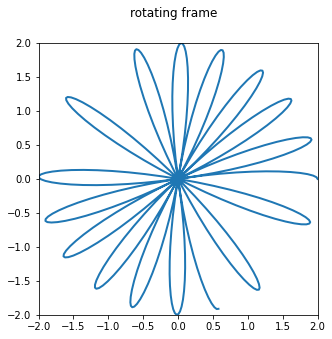

In [ ]:
rotation = True
w0 = -10

dt = 1                      # time step
nt = 1000                   # iterations
T = 40*np.pi/w0             # integration time = 20 * natural period of pendulum  

# rotation in clockwise and anti-clockwise direction
a1 = -1 - np.sqrt(1 + w0**2)
a2 = -1 + np.sqrt(1 + w0**2)

t = np.linspace(0,T,nt*dt)  # time axis

if rotation==True:
  z = np.exp(1j*a1*t) + np.exp(1j*a2*t)  # solution in rotating frame
  a = 2                                  # release position in the rotating frame

  title='rotating frame'
else:
  z = np.exp(1j*w0*t) + np.exp(-1j*w0*t)   # solution in fixed frame
  a = 2*np.exp(1j*t)                     # release position in the  fixed frame

  title='fixed frame'



# Animation
# First set up the figure, the axis, and the plot element we want to animate
fig = plt.figure(figsize=(5,5))
fig.suptitle(title)
ax = plt.axes(xlim=(-2, 2), ylim=(-2, 2))
line, = ax.plot([], [], lw=2)

# initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    return line,

# animation function.  This is called sequentially
def animate(i):
    line.set_data(z[:i].real,z[:i].imag)
    return line,
# call the animator.  blit=True means only re-draw the parts that have changed.


anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=400, interval=1, blit=True)

anim # takes ~30seconds? maybe implement progressbar package?


# REFACTOR TO FOLLOW THIS https://colab.research.google.com/github/jckantor/CBE30338/blob/master/docs/A.03-Animation-in-Jupyter-Notebooks.ipynb
# Maybe plot over projection of earth?

In [ ]:
from IPython.display import HTML
HTML(anim.to_html5_video())

In [ ]:
#https://colab.research.google.com/github/phoebe-project/phoebe2-docs/blob/2.1/tutorials/animations.ipynb#scrollTo=BtAymiiZcpuv

In [ ]:

zR = np.exp(1j*a1*t) + np.exp(1j*a2*t)  # solution in rotating frame
z0 = np.exp(1j*w0*t) + np.exp(-1j*w0*t) # solution in fixed frame
aR = 2                                  # release position in the rotating frame
a0 = 2*np.exp(1j*t)                     # release position in the  fixed frame

In [ ]:
# First set up the figure, the axis, and the plot element we want to animate
fig = plt.figure(figsize=(5,5))
ax = plt.axes(xlim=(-2, 2), ylim=(-2, 2))
line, = ax.plot([], [], lw=2)
scatters1, = ax.scatter([], [])
scatters2, = ax.scatter([], [])

# initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    scatters1.set_data([], [])

    scatters2.set_data([], [])
    return line, scatters1, scatters2,

rotation=True
# animation function.  This is called sequentially

dt = 1                      # time step
nt = 1000                   # iterations
T = 40*np.pi/w0             # integration time = 20 * natural period of pendulum  

# rotation in clockwise and anti-clockwise direction
a1 = -1 - np.sqrt(1 + w0**2)
a2 = -1 + np.sqrt(1 + w0**2)

t = np.linspace(0,T,nt*dt)  # time axis

if rotation==True:
  z = np.exp(1j*a1*t) + np.exp(1j*a2*t)  # solution in rotating frame
  a = 2                                  # release position in the rotating frame

  title='rotating frame'
else:
  z = np.exp(1j*w*t) + np.exp(-1j*w*t)   # solution in fixed frame
  a = 2*np.exp(1j*t)                     # release position in the  fixed frame

  title='fixed frame'

def animate(i):
    line.set_data(z[:i].real,z[:i].imag)
    if rotation == True:
      scatters1.set_data(a.real,a.imag)
    else:
      scatters1.set_data(a[i].real,a[i].imag)

    scatters2.set_data(z[int(max_time)-1].real,z[int(max_time)-1].imag, zorder=10)
    return line, scatters1, scatters2,

# call the animator.  blit=True means only re-draw the parts that have changed.
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=400, interval=1, blit=True)


#https://colab.research.google.com/github/phoebe-project/phoebe2-docs/blob/2.1/tutorials/animations.ipynb#scrollTo=BtAymiiZcpuv

Saved trajectory snapshot 0
Saved trajectory snapshot 1
Saved trajectory snapshot 2
Saved trajectory snapshot 3
Saved trajectory snapshot 4
Saved trajectory snapshot 5
Saved trajectory snapshot 6
Saved trajectory snapshot 7
Saved trajectory snapshot 8
Saved trajectory snapshot 9
Saved trajectory snapshot 10
Saved trajectory snapshot 11
Saved trajectory snapshot 12
Saved trajectory snapshot 13
Saved trajectory snapshot 14
Saved trajectory snapshot 15
Saved trajectory snapshot 16
Saved trajectory snapshot 17
Saved trajectory snapshot 18
Saved trajectory snapshot 19
Saved trajectory snapshot 20
Saved trajectory snapshot 21
Saved trajectory snapshot 22
Saved trajectory snapshot 23
Saved trajectory snapshot 24
Saved trajectory snapshot 25
Saved trajectory snapshot 26
Saved trajectory snapshot 27
Saved trajectory snapshot 28
Saved trajectory snapshot 29
Saved trajectory snapshot 30
Saved trajectory snapshot 31
Saved trajectory snapshot 32
Saved trajectory snapshot 33
Saved trajectory snapsho

KeyboardInterrupt: ignored

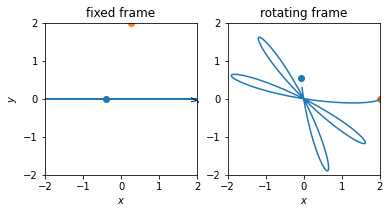

In [ ]:
for i in range(nt-1):
   
    # Plot trajectory in rotating and fixed frames
    ax = plt.subplot(1,2,1)
    ax.plot(z0[:i*dt+1].real,z0[:i*dt+1].imag)
    ax.scatter(z0[i*dt+1].real,z0[i*dt+1].imag)
    ax.scatter(a0[i*dt+1].real,a0[i*dt+1].imag)
    ax.set(aspect=1,xlabel='$x$',ylabel='$y$',xlim=[-2,2],ylim=[-2,2],title='fixed frame')

    ax = plt.subplot(1,2,2)
    ax.plot(zR[:i*dt+1].real,zR[:i*dt+1].imag)
    ax.scatter(zR[i*dt+1].real,zR[i*dt+1].imag)
    ax.scatter(aR.real,aR.imag)
    ax.set(aspect=1,xlabel='$x$',ylabel='$y$',xlim=[-2,2],ylim=[-2,2],title='rotating frame')
    
    plt.savefig('foucault_{:0>4d}.png'.format(i),dpi=200,bbox_inches='tight')
    plt.close()
    print('Saved trajectory snapshot {:d}'.format(i))

In [ ]:
def save_movie(image_filenames,movie_filename,framerate):
    os.system('ffmpeg -r ' + str(framerate) + ' -i ' + image_filenames + ' -vcodec mpeg4 -y ' + movie_filename)
    #os.system("ffmpeg -r 30 -i img%01d.png -vcodec mpeg4 -y movie.mp4")

In [ ]:
import os

# make movie
save_movie("foucault_%04d.png","foucault.mp4",20)